# Exercise 12: MFKZIZ004

In [48]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
# constants
SECPERDAY = 86400.
M2KM = 1000

In [50]:
# problem parameters
kappa= 2.0e3   # Eddy diffusion coefficient [m2 s-1]
dx=500         # X resolution [m]
dt=20         # time step [s]
t0=0.          # initial time
tmax=0.12      # duration of simulation [days]
xmax=10.0e3    # length of the basin [m]

# Parameters of the initial DIN spillage
N0 = 20.       # baseline concentration [mmol/m3]
sigma = 1000.  # width [m]
A = 100.       # amplitude [mmol/m3]

In [52]:
# Spatial shape of the initial DIN concentration
def Gaussian(x):
    y = N0+A*np.exp(-(x/sigma)**2)
    return y

In [54]:
# time axis
NT = int(np.floor(tmax*86400/dt))+1  # number of steps (starts from 0)
# X axis (centred at 0)
x = np.arange(-xmax,xmax,dx)
IM = len(x)             # number of grid points
N = np.zeros([IM,NT])   # the array holding the numerical solution 
print('Grid steps : ',IM)
print('Number of time steps : ',NT)
print('Timestep = ',dt,' s')
print('Max numerical diffusion DX^2/DT = ',dx**2/dt,' m2/s')
print('Physical diffusion = ',kappa,' m2/s')
print('Courant number (diffusion) = ',kappa*dt/(dx**2))

Grid steps :  40
Number of time steps :  519
Timestep =  20  s
Max numerical diffusion DX^2/DT =  12500.0  m2/s
Physical diffusion =  2000.0  m2/s
Courant number (diffusion) =  0.16


In [56]:
# Compute the numerical solution using a time loop over the number of time steps
N[:,0] = Gaussian(x)    # initial condition

for n in range(NT-1):
    # Question 2
    N[0,n+1]  = N[1,n]
    N[-1,n+1] = N[-2,n]
    # discretization of the second derivative
    rhs = kappa*(N[:-2,n]-2*N[1:-1,n]+N[2:,n])/(dx**2)
    N[1:-1,n+1] = N[1:-1,n] + rhs*dt    

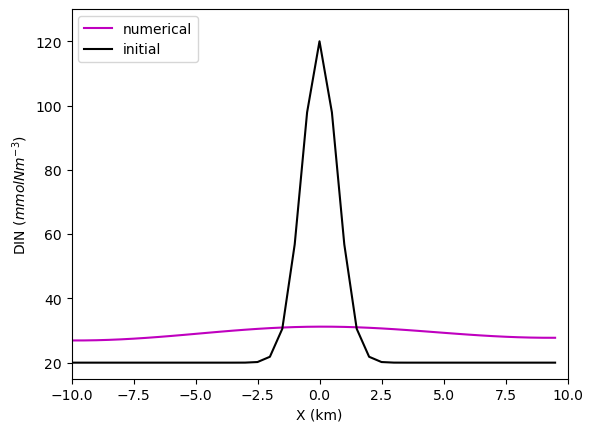

In [58]:
fig, ax = plt.subplots()
# set the axis limits
plt.axis([-xmax/M2KM, xmax/M2KM, N0-5, N0+A+10])
# first plot the initial condition and set the line attributes
sol, = ax.plot(x/M2KM, N[:,0],'m',label='numerical')
line, = ax.plot(x/M2KM, Gaussian(x),'k',label='initial')
ax.set_xlabel('X (km)')
ax.set_ylabel('DIN ($mmol N m^{-3}$)')
plt.legend(loc='upper left')

def animate(i):
    sol.set_ydata(N[:,i])  # update the numerical solution
    return sol,

# create the animation and loop (interval is in ms)
ani = animation.FuncAnimation(
    fig, animate, interval=dt, blit=True, frames=NT, repeat=True)

# display the animation as a javascript object embedded in the notebook
from IPython.display import HTML
HTML(ani.to_jshtml())

#### (1) Study the numerical solution. Why does the flattening of the peak slow down with time?
- It slows down with time because the gradient in the concentration of DIN has become more uniform in the surrounding points. At the beginning of the model, the peak had a higher concentration of DIN than surrounding points. So what happenend was the movement of DIN from the oeak to the surrounding areas was quicker.
- As diffusion takes pleace that DIN gradient decreases and this makes the movement of the DIN to the surrounding points slower, this is the main reason why we see the flattening of the peak slow down with time. 

#### (2) How would you describe Neumann conditions? Change the boundary conditions to the ones used in the advection equation.  Run this code and compare it with the original: why do you think the Neumann boundary conditions are more realistic?

<>:63: SyntaxWarning: invalid escape sequence '\ '
<>:63: SyntaxWarning: invalid escape sequence '\ '
C:\Users\mfaku\AppData\Local\Temp\ipykernel_30740\3432195581.py:63: SyntaxWarning: invalid escape sequence '\ '
  ax.set_ylabel('DIN ($mmol\ N\ m^{-3}$)')


Grid steps :  41
Number of time steps :  104
Timestep =  100  s
Max numerical diffusion DX^2/DT =  2500.0  m2/s
Physical diffusion =  1000.0  m2/s
Courant number (diffusion) =  0.4


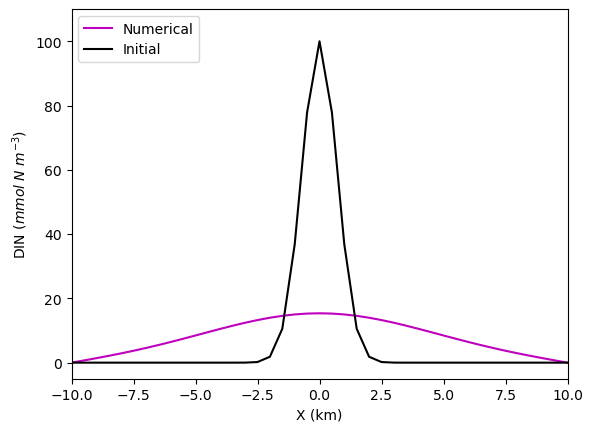

In [19]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

# constants
SECPERDAY = 86400.
M2KM = 1000

# problem parameters
kappa = 1.0e3    # Eddy diffusion coefficient [m^2/s]
dx = 500         # X resolution [m]
dt = 100         # Time step [s]
t0 = 0.          # Initial time
tmax = 0.12      # Duration of simulation [days]
xmax = 10.0e3    # Half-length of the basin [m]

# Parameters of the initial DIN spillage
N0 = 0.          # Baseline concentration [mmol/m^3]
sigma = 1000.    # Width of the initial Gaussian [m]
A = 100.         # Amplitude [mmol/m^3]

# Spatial shape of the initial DIN concentration
def Gaussian(x):
    return N0 + A * np.exp(-(x / sigma) ** 2)

# Time axis
NT = int(np.floor(tmax * SECPERDAY / dt)) + 1  # number of time steps
time = np.linspace(t0, tmax * SECPERDAY, NT)

# Spatial axis
x = np.arange(-xmax, xmax + dx, dx)
IM = len(x)

# Numerical solution array
N = np.zeros((IM, NT))
N[:, 0] = Gaussian(x)  # Initial condition

# Grid info
print('Grid steps : ', IM)
print('Number of time steps : ', NT)
print('Timestep = ', dt, ' s')
print('Max numerical diffusion DX^2/DT = ', dx**2 / dt, ' m2/s')
print('Physical diffusion = ', kappa, ' m2/s')
print('Courant number (diffusion) = ', kappa * dt / dx**2)

# Time stepping loop
for n in range(NT - 1):
    # Dirichlet Boundary Conditions (fixed value)
    N[0, n + 1] = N0
    N[-1, n + 1] = N0

    # Discretization of second derivative (diffusion equation)
    rhs = kappa * (N[:-2, n] - 2 * N[1:-1, n] + N[2:, n]) / dx**2
    N[1:-1, n + 1] = N[1:-1, n] + rhs * dt

# Plotting setup
fig, ax = plt.subplots()
plt.axis([-xmax / M2KM, xmax / M2KM, N0 - 5, N0 + A + 10])
sol, = ax.plot(x / M2KM, N[:, 0], 'm', label='Numerical')
line, = ax.plot(x / M2KM, Gaussian(x), 'k', label='Initial')
ax.set_xlabel('X (km)')
ax.set_ylabel('DIN ($mmol\ N\ m^{-3}$)')
plt.legend(loc='upper left')

# Animation function
def animate(i):
    sol.set_ydata(N[:, i])
    return sol,

# Animate
ani = animation.FuncAnimation(
    fig, animate, interval=dt, blit=True, frames=NT, repeat=True)

HTML(ani.to_jshtml())


#### why do you think the Neumann boundary conditions are more realistic?
- The Dirichlet conditions that we madee use of when doing the advection exrecise had boundary conditions being fixed to 15°C this meant that it assumed that the heat of a substance would be contained between those conditions. The Neumann boundary conditions on the other hand does not have conditions fixed this means that the heat of the substance can be seen outside of the domain which is more realistic as this is something that can happen in the real world. 

#### (3)  What happens if you double the diffusivity coefficient? [you can adjust the y-axis limits to see the behaviour better]. What would you do to fix it and why?
- When i doubled the diffusity coefficient to  2.0e3 and I also had to lower dt to 20 m/s or the larger dt would have resulted in a very high courant number. I saw that the numerical solution's peak is flattening quicker and this means that the diffusion rate is quicker. Furthermore, this means that there is less turbulence.
- To fix trhe issue that comes with increasing, I would decrease my dt as I have seen with higher dt and higher kappa the model will be unstable. I would also increase my space (dx) because this will create more space for the diffusion to happen as the increase in kappa make the diffusion quicker (makes the spread of the substance quicker). 